# Лабораторна робота №1
## Навчання з учителем у комп'ютерному зорі: від класифікації зображень до семантичної сегментації

**Дисципліна:** Штучний інтелект в ігрових застосунках

**Мета:** Ознайомитись з основними задачами комп'ютерного зору; створити й натренувати модель класифікації зображень із використанням передавального навчання; дослідити рішення моделі за допомогою Grad-CAM; ознайомитися із семантичною сегментацією; побудувати комбінований конвеєр.

---
## Етап 1. Налаштування середовища розробки

Переконайтеся, що ви працюєте з GPU середовищем (Google Colab T4 через VS Code або безпосередньо).

In [ ]:
# 1.1 Перевірка GPU
import torch

print(f"PyTorch version: {torch.__version__}")
print(f"CUDA available: {torch.cuda.is_available()}")

CUDA_WORKS = False
if torch.cuda.is_available():
    gpu_name = torch.cuda.get_device_name(0)
    capability = torch.cuda.get_device_capability(0)
    print(f"GPU: {gpu_name}")
    print(f"CUDA capability: {capability[0]}.{capability[1]}")

    # Перевіряємо, чи GPU реально підтримується цією версією PyTorch
    # (деякі старі GPU мають capability < 7.0, що не підтримується новими PyTorch)
    try:
        _test = torch.tensor([1.0], device="cuda") + torch.tensor([1.0], device="cuda")
        CUDA_WORKS = True
        print("GPU перевірка: OK")
    except RuntimeError as e:
        print(f"\nGPU виявлено, але воно НЕ ПІДТРИМУЄТЬСЯ цією версією PyTorch!")
        print(f"Помилка: {e}")
        print("\nМожливі рішення:")
        print("  1. Використайте Google Colab з GPU T4 (рекомендовано)")
        print("  2. Встановіть VS Code розширення Google Colab для доступу до хмарного GPU")
        print("  3. Встановіть старішу версію PyTorch, що підтримує вашу GPU")
        print("\nПродовжуємо на CPU (тренування буде повільнішим)...")
else:
    print("GPU не знайдено.")
    print("Рекомендовано використовувати Google Colab з GPU T4.")

print(f"\nВикористовуємо: {'GPU' if CUDA_WORKS else 'CPU'}")

PyTorch version: 2.9.0+cu128
CUDA available: True
GPU: Tesla T4
CUDA capability: 7.5
GPU перевірка: OK

Використовуємо: GPU


In [2]:
# 1.2 Встановлення додаткових бібліотек
!pip install -q matplotlib numpy Pillow

In [3]:
# 1.3 Імпорт основних модулів
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset, random_split
from torchvision import transforms, models, datasets
from torchvision.models import ResNet18_Weights
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import os
from pathlib import Path

# Використовуємо GPU тільки якщо він реально працює (перевірено в ячейці 1.1)
device = torch.device("cuda" if CUDA_WORKS else "cpu")
print(f"Використовуємо пристрій: {device}")
if device.type == "cpu":
    print("Увага: тренування на CPU буде значно повільнішим.")
    print("Для прискорення підключіть Google Colab GPU через VS Code.")

Використовуємо пристрій: cuda


---
## Етап 2. Підготовка набору даних

На цьому етапі ви завантажите набір даних з `torchvision.datasets` та підготуєте його для бінарної класифікації.

**Доступні набори даних:**
- **Oxford-IIIT Pet** — 37 порід котів і собак (~7400 зображень). Рекомендовано, оскільки коти й собаки є класами COCO і добре сегментуються.
- **Caltech-101** — 101 категорія об'єктів (~9000 зображень).

**⚠️ Замініть значення `DATASET_NAME`, `CLASS_A`, `CLASS_B` відповідно до вашого індивідуального варіанта!**

In [6]:
# 2.1 Налаштування набору даних (ЗАМІНІТЬ НА СВІЙ ВАРІАНТ!)

DATASET_NAME = "OxfordIIITPet"  # або "Caltech101"

CLASS_A = "Siamese"    # Назва першого класу (точна назва з набору даних)
CLASS_B = "Persian"    # Назва другого класу

print(f"Набір даних: {DATASET_NAME}")
print(f"Клас A: {CLASS_A}")
print(f"Клас B: {CLASS_B}")

Набір даних: OxfordIIITPet
Клас A: Siamese
Клас B: Persian


In [7]:
# 2.2 Завантаження набору даних та фільтрація двох класів

from torchvision.datasets import OxfordIIITPet, Caltech101

if DATASET_NAME == "OxfordIIITPet":
    raw_dataset = OxfordIIITPet(root="data", split="trainval", download=True)
    all_classes = raw_dataset.classes
elif DATASET_NAME == "Caltech101":
    raw_dataset = Caltech101(root="data", download=True)
    all_classes = raw_dataset.categories
else:
    raise ValueError(f"Невідомий набір даних: {DATASET_NAME}")

print(f"Кількість класів: {len(all_classes)}")
print(f"Усі класи: {all_classes}")

# Знаходимо індекси обраних класів
idx_a = all_classes.index(CLASS_A)
idx_b = all_classes.index(CLASS_B)
print(f"\nІндекс '{CLASS_A}': {idx_a}")
print(f"Індекс '{CLASS_B}': {idx_b}")

# Фільтруємо зображення лише для двох обраних класів
filtered_images = []  # список (PIL.Image, binary_label)
for i in range(len(raw_dataset)):
    img, label = raw_dataset[i]
    if label == idx_a:
        filtered_images.append((img, 0))
    elif label == idx_b:
        filtered_images.append((img, 1))

print(f"\nВідфільтровано: {len(filtered_images)} зображень")
print(f"  Клас 0 ({CLASS_A}): {sum(1 for _, l in filtered_images if l == 0)}")
print(f"  Клас 1 ({CLASS_B}): {sum(1 for _, l in filtered_images if l == 1)}")

Кількість класів: 37
Усі класи: ['Abyssinian', 'American Bulldog', 'American Pit Bull Terrier', 'Basset Hound', 'Beagle', 'Bengal', 'Birman', 'Bombay', 'Boxer', 'British Shorthair', 'Chihuahua', 'Egyptian Mau', 'English Cocker Spaniel', 'English Setter', 'German Shorthaired', 'Great Pyrenees', 'Havanese', 'Japanese Chin', 'Keeshond', 'Leonberger', 'Maine Coon', 'Miniature Pinscher', 'Newfoundland', 'Persian', 'Pomeranian', 'Pug', 'Ragdoll', 'Russian Blue', 'Saint Bernard', 'Samoyed', 'Scottish Terrier', 'Shiba Inu', 'Siamese', 'Sphynx', 'Staffordshire Bull Terrier', 'Wheaten Terrier', 'Yorkshire Terrier']

Індекс 'Siamese': 32
Індекс 'Persian': 23

Відфільтровано: 199 зображень
  Клас 0 (Siamese): 99
  Клас 1 (Persian): 100


In [8]:
# 2.3 Збереження відфільтрованих зображень на диск
# (для зручності роботи з Grad-CAM та сегментацією на наступних етапах)

os.makedirs(f"dataset/{CLASS_A}", exist_ok=True)
os.makedirs(f"dataset/{CLASS_B}", exist_ok=True)

classes_list = [CLASS_A, CLASS_B]
saved_counts = [0, 0]

for img, label in filtered_images:
    cls_name = classes_list[label]
    idx = saved_counts[label]
    save_path = f"dataset/{cls_name}/img_{idx:04d}.jpg"
    img.convert("RGB").save(save_path)
    saved_counts[label] += 1

print(f"Збережено на диск:")
print(f"  dataset/{CLASS_A}/: {saved_counts[0]} зображень")
print(f"  dataset/{CLASS_B}/: {saved_counts[1]} зображень")

Збережено на диск:
  dataset/Siamese/: 99 зображень
  dataset/Persian/: 100 зображень


In [9]:
# 2.4 Перевірка збережених зображень


def verify_images(folder):
    """Перевіряє зображення у папці та видаляє пошкоджені."""
    removed = 0
    total = 0
    for f in Path(folder).glob("*"):
        if f.is_dir():
            continue
        total += 1
        try:
            img = Image.open(f)
            img.verify()
        except Exception:
            f.unlink()
            removed += 1
    print(f"{folder}: перевірено {total}, видалено {removed} пошкоджених")
    return total - removed


count_a = verify_images(f"dataset/{CLASS_A}")
count_b = verify_images(f"dataset/{CLASS_B}")
print(f"\nВсього придатних зображень: {count_a} ({CLASS_A}) + {count_b} ({CLASS_B}) = {count_a + count_b}")

dataset/Siamese: перевірено 99, видалено 0 пошкоджених
dataset/Persian: перевірено 100, видалено 0 пошкоджених

Всього придатних зображень: 99 (Siamese) + 100 (Persian) = 199


In [10]:
# 2.5 Клас Dataset для бінарної класифікації


class ImageClassificationDataset(Dataset):
    """Набір даних для бінарної класифікації зображень."""

    def __init__(self, root_dir, transform=None):
        self.root_dir = Path(root_dir)
        self.transform = transform
        self.classes = sorted([d.name for d in self.root_dir.iterdir() if d.is_dir()])
        self.class_to_idx = {cls: idx for idx, cls in enumerate(self.classes)}

        self.images = []
        self.labels = []
        for cls in self.classes:
            cls_dir = self.root_dir / cls
            for img_path in cls_dir.glob("*"):
                if img_path.is_file():
                    self.images.append(img_path)
                    self.labels.append(self.class_to_idx[cls])

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path).convert("RGB")
        label = self.labels[idx]
        if self.transform:
            image = self.transform(image)
        return image, label


print("Клас ImageClassificationDataset визначено.")

Клас ImageClassificationDataset визначено.


In [11]:
# 2.6 Визначення трансформацій

# Нормалізація ImageNet (стандартні значення для попередньо натренованих моделей)
IMAGENET_MEAN = [0.485, 0.456, 0.406]
IMAGENET_STD = [0.229, 0.224, 0.225]

# Трансформації для тренувального набору (з аугментацією)
train_transform = transforms.Compose([
    transforms.RandomResizedCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),
    transforms.RandomRotation(15),
    transforms.ToTensor(),
    transforms.Normalize(mean=IMAGENET_MEAN, std=IMAGENET_STD),
])

# Трансформації для валідаційного набору (без аугментації)
val_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=IMAGENET_MEAN, std=IMAGENET_STD),
])

print("Трансформації визначено.")

Трансформації визначено.


In [12]:
# 2.7 Розділення на тренувальну та валідаційну вибірки

full_dataset = ImageClassificationDataset("dataset", transform=None)
print(f"Загальний розмір набору даних: {len(full_dataset)}")
print(f"Класи: {full_dataset.classes}")
print(f"Відповідність класів до індексів: {full_dataset.class_to_idx}")

# Розділення: 80% тренування, 20% валідація
train_size = int(0.8 * len(full_dataset))
val_size = len(full_dataset) - train_size

generator = torch.Generator().manual_seed(42)  # Для відтворюваності
train_indices, val_indices = random_split(
    range(len(full_dataset)), [train_size, val_size], generator=generator
)

print(f"\nТренувальна вибірка: {len(train_indices)} зображень")
print(f"Валідаційна вибірка: {len(val_indices)} зображень")

Загальний розмір набору даних: 199
Класи: ['Persian', 'Siamese']
Відповідність класів до індексів: {'Persian': 0, 'Siamese': 1}

Тренувальна вибірка: 159 зображень
Валідаційна вибірка: 40 зображень


In [13]:
# 2.8 Створення DataLoader з різними трансформаціями


class SubsetWithTransform(Dataset):
    """Підмножина набору даних з окремими трансформаціями."""

    def __init__(self, dataset, indices, transform):
        self.dataset = dataset
        self.indices = list(indices)
        self.transform = transform

    def __len__(self):
        return len(self.indices)

    def __getitem__(self, idx):
        real_idx = self.indices[idx]
        img_path = self.dataset.images[real_idx]
        image = Image.open(img_path).convert("RGB")
        label = self.dataset.labels[real_idx]
        if self.transform:
            image = self.transform(image)
        return image, label


train_dataset = SubsetWithTransform(full_dataset, train_indices, train_transform)
val_dataset = SubsetWithTransform(full_dataset, val_indices, val_transform)

BATCH_SIZE = 32
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False)

print(f"Тренувальний DataLoader: {len(train_loader)} батчів по {BATCH_SIZE}")
print(f"Валідаційний DataLoader: {len(val_loader)} батчів по {BATCH_SIZE}")

Тренувальний DataLoader: 5 батчів по 32
Валідаційний DataLoader: 2 батчів по 32


Приклади з тренувального набору:


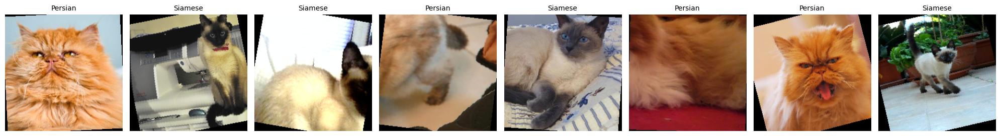


Приклади з валідаційного набору:


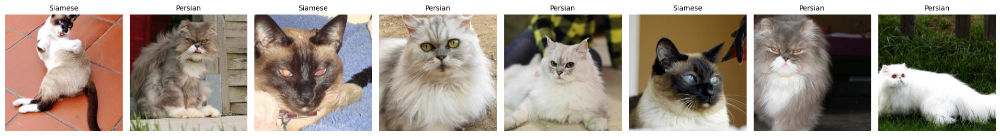

In [14]:
# 2.9 Візуалізація зображень з набору даних


def denormalize(tensor, mean=IMAGENET_MEAN, std=IMAGENET_STD):
    """Скасовує нормалізацію ImageNet для візуалізації."""
    img = tensor.numpy().transpose((1, 2, 0))
    img = np.array(std) * img + np.array(mean)
    return np.clip(img, 0, 1)


def show_batch(dataloader, classes, n=8):
    """Показує перші n зображень з батча."""
    images, labels = next(iter(dataloader))
    n = min(n, len(images))
    fig, axes = plt.subplots(1, n, figsize=(2.5 * n, 3))
    if n == 1:
        axes = [axes]
    for i in range(n):
        img = denormalize(images[i])
        axes[i].imshow(img)
        axes[i].set_title(classes[labels[i]], fontsize=10)
        axes[i].axis("off")
    plt.tight_layout()
    plt.show()


print("Приклади з тренувального набору:")
show_batch(train_loader, full_dataset.classes)

print("\nПриклади з валідаційного набору:")
show_batch(val_loader, full_dataset.classes)

---
## Етап 3. Класифікація зображень із передавальним навчанням

Використаємо попередньо натреновану ResNet-18 (навчену на ImageNet). Заморозимо базові шари та замінимо останній повнозв'язний шар для нашої бінарної задачі.

In [15]:
# 3.1 Завантаження попередньо натренованої моделі та адаптація

model = models.resnet18(weights=ResNet18_Weights.IMAGENET1K_V1)

# Заморожуємо всі шари базової мережі
for param in model.parameters():
    param.requires_grad = False

# Замінюємо останній повнозв'язний шар
num_features = model.fc.in_features
model.fc = nn.Sequential(
    nn.Dropout(0.3),
    nn.Linear(num_features, 2),  # 2 класи
)

model = model.to(device)

# Підрахунок параметрів
total_params = sum(p.numel() for p in model.parameters())
trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f"Загальна кількість параметрів: {total_params:,}")
print(f"Тренувальних параметрів: {trainable_params:,}")
print(f"Заморожених параметрів: {total_params - trainable_params:,}")
print(f"\nМодель працює на: {device}")

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


100%|██████████| 44.7M/44.7M [00:00<00:00, 190MB/s]


Загальна кількість параметрів: 11,177,538
Тренувальних параметрів: 1,026
Заморожених параметрів: 11,176,512

Модель працює на: cuda


In [16]:
# 3.2 Функція втрат, оптимізатор та функції тренування/валідації

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.fc.parameters(), lr=0.001)
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.1)


def train_one_epoch(model, dataloader, criterion, optimizer, device):
    """Тренує модель протягом однієї епохи."""
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0

    for images, labels in dataloader:
        images, labels = images.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * images.size(0)
        _, predicted = outputs.max(1)
        total += labels.size(0)
        correct += predicted.eq(labels).sum().item()

    return running_loss / total, correct / total


def evaluate(model, dataloader, criterion, device):
    """Оцінює модель на валідаційному наборі."""
    model.eval()
    running_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
        for images, labels in dataloader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)

            running_loss += loss.item() * images.size(0)
            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()

    return running_loss / total, correct / total


print("Функції тренування та валідації готові.")

Функції тренування та валідації готові.


In [17]:
# 3.3 Тренування моделі

NUM_EPOCHS = 10

train_losses, val_losses = [], []
train_accs, val_accs = [], []

print(f"Початок тренування ({NUM_EPOCHS} епох)...")
print("-" * 70)

for epoch in range(NUM_EPOCHS):
    train_loss, train_acc = train_one_epoch(
        model, train_loader, criterion, optimizer, device
    )
    val_loss, val_acc = evaluate(model, val_loader, criterion, device)
    scheduler.step()

    train_losses.append(train_loss)
    val_losses.append(val_loss)
    train_accs.append(train_acc)
    val_accs.append(val_acc)

    print(
        f"Епоха {epoch + 1:2d}/{NUM_EPOCHS} | "
        f"Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.4f} | "
        f"Val Loss: {val_loss:.4f} | Val Acc: {val_acc:.4f}"
    )

print("-" * 70)
print(f"Найкраща валідаційна точність: {max(val_accs):.4f}")

Початок тренування (10 епох)...
----------------------------------------------------------------------
Епоха  1/10 | Train Loss: 0.6741 | Train Acc: 0.6226 | Val Loss: 0.5007 | Val Acc: 0.7000
Епоха  2/10 | Train Loss: 0.5673 | Train Acc: 0.6415 | Val Loss: 0.2885 | Val Acc: 1.0000
Епоха  3/10 | Train Loss: 0.4132 | Train Acc: 0.8365 | Val Loss: 0.2154 | Val Acc: 1.0000
Епоха  4/10 | Train Loss: 0.3551 | Train Acc: 0.8805 | Val Loss: 0.1701 | Val Acc: 1.0000
Епоха  5/10 | Train Loss: 0.2974 | Train Acc: 0.8931 | Val Loss: 0.1369 | Val Acc: 1.0000
Епоха  6/10 | Train Loss: 0.2921 | Train Acc: 0.8868 | Val Loss: 0.1387 | Val Acc: 1.0000
Епоха  7/10 | Train Loss: 0.2407 | Train Acc: 0.9434 | Val Loss: 0.1393 | Val Acc: 1.0000
Епоха  8/10 | Train Loss: 0.2658 | Train Acc: 0.9119 | Val Loss: 0.1378 | Val Acc: 1.0000
Епоха  9/10 | Train Loss: 0.2782 | Train Acc: 0.8994 | Val Loss: 0.1359 | Val Acc: 1.0000
Епоха 10/10 | Train Loss: 0.2373 | Train Acc: 0.9371 | Val Loss: 0.1345 | Val Acc: 1.00

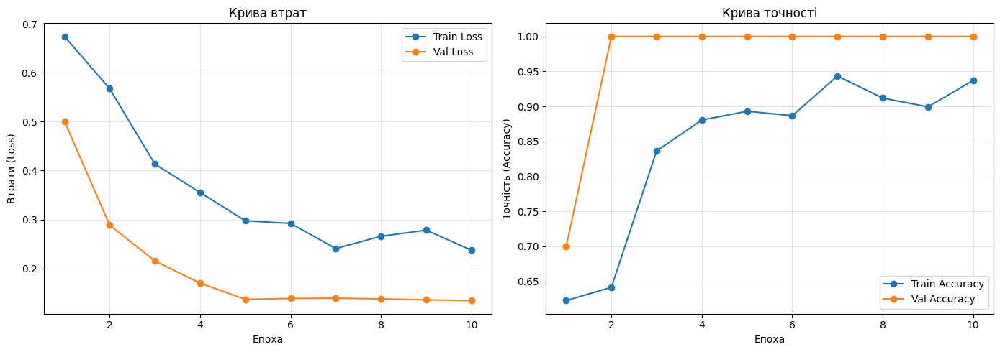

In [18]:
# 3.4 Графіки навчання

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

epochs_range = range(1, NUM_EPOCHS + 1)

ax1.plot(epochs_range, train_losses, "o-", label="Train Loss")
ax1.plot(epochs_range, val_losses, "o-", label="Val Loss")
ax1.set_xlabel("Епоха")
ax1.set_ylabel("Втрати (Loss)")
ax1.set_title("Крива втрат")
ax1.legend()
ax1.grid(True, alpha=0.3)

ax2.plot(epochs_range, train_accs, "o-", label="Train Accuracy")
ax2.plot(epochs_range, val_accs, "o-", label="Val Accuracy")
ax2.set_xlabel("Епоха")
ax2.set_ylabel("Точність (Accuracy)")
ax2.set_title("Крива точності")
ax2.legend()
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

Тестування на зображеннях з валідаційного набору:



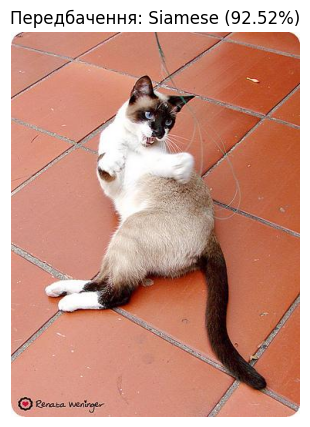

  img_0096.jpg -> Siamese (92.52%)


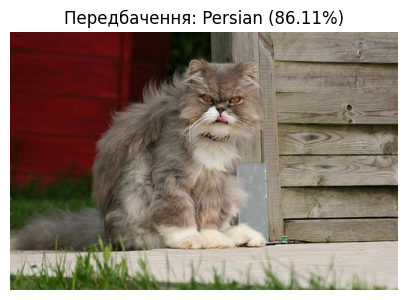

  img_0084.jpg -> Persian (86.11%)


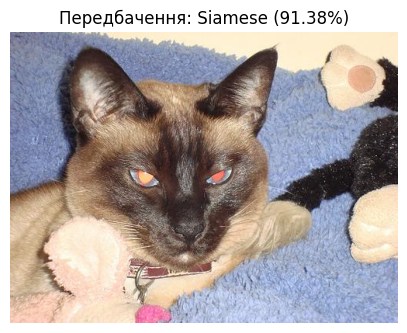

  img_0058.jpg -> Siamese (91.38%)


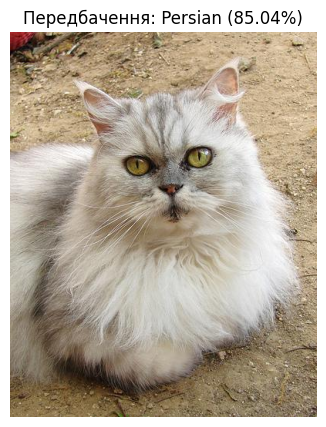

  img_0006.jpg -> Persian (85.04%)


In [19]:
# 3.5 Тестування моделі на окремих зображеннях


def predict_image(model, image_path, transform, classes, device):
    """Класифікує одне зображення та виводить результат."""
    image = Image.open(image_path).convert("RGB")
    input_tensor = transform(image).unsqueeze(0).to(device)

    model.eval()
    with torch.no_grad():
        output = model(input_tensor)
        probabilities = torch.softmax(output, dim=1)
        predicted_class = probabilities.argmax(dim=1).item()
        confidence = probabilities[0, predicted_class].item()

    plt.figure(figsize=(5, 5))
    plt.imshow(image)
    plt.title(f"Передбачення: {classes[predicted_class]} ({confidence:.2%})")
    plt.axis("off")
    plt.show()

    return classes[predicted_class], confidence


# Тестуємо на кількох зображеннях з валідаційного набору
print("Тестування на зображеннях з валідаційного набору:\n")
test_images = [full_dataset.images[i] for i in list(val_indices)[:4]]
for img_path in test_images:
    pred_class, conf = predict_image(
        model, img_path, val_transform, full_dataset.classes, device
    )
    print(f"  {img_path.name} -> {pred_class} ({conf:.2%})")

---
## Етап 4. Візуалізація рішень моделі за допомогою Grad-CAM

Grad-CAM (Gradient-weighted Class Activation Mapping) показує, на які частини зображення "дивиться" модель при класифікації. Це теплова карта, де яскравіші ділянки мають більший вплив на рішення моделі.

**Принцип:** обчислюємо градієнти скору цільового класу відносно карт ознак останнього згорткового шару, усереднюємо їх та використовуємо як ваги для зваженої суми карт ознак.

In [20]:
# 4.1 Реалізація Grad-CAM


class GradCAM:
    """Реалізація Grad-CAM для візуалізації рішень CNN."""

    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None

        # Реєструємо хуки для збору градієнтів та активацій
        self._forward_handle = target_layer.register_forward_hook(self._forward_hook)
        self._backward_handle = target_layer.register_full_backward_hook(
            self._backward_hook
        )

    def _forward_hook(self, module, input, output):
        self.activations = output.detach()

    def _backward_hook(self, module, grad_input, grad_output):
        self.gradients = grad_output[0].detach()

    def generate(self, input_tensor, target_class=None):
        """Генерує теплову карту Grad-CAM."""
        self.model.eval()
        output = self.model(input_tensor)

        if target_class is None:
            target_class = output.argmax(dim=1).item()

        self.model.zero_grad()
        output[0, target_class].backward()

        # Ваги: середнє градієнтів по просторових вимірах
        weights = self.gradients.mean(dim=[2, 3], keepdim=True)

        # Зважена сума активацій + ReLU
        cam = (weights * self.activations).sum(dim=1, keepdim=True)
        cam = torch.relu(cam)

        # Нормалізація до [0, 1]
        cam = cam - cam.min()
        if cam.max() > 0:
            cam = cam / cam.max()

        return cam.squeeze().cpu().numpy(), target_class

    def remove_hooks(self):
        """Видаляє зареєстровані хуки."""
        self._forward_handle.remove()
        self._backward_handle.remove()


print("Клас GradCAM визначено.")

Клас GradCAM визначено.


In [21]:
# 4.2 Функція візуалізації Grad-CAM


def visualize_gradcam(model, image_path, transform, classes, device):
    """Візуалізує оригінальне зображення, теплову карту та їх накладення."""
    # Створюємо Grad-CAM для останнього згорткового шару ResNet-18
    grad_cam = GradCAM(model, model.layer4[-1].conv2)

    image = Image.open(image_path).convert("RGB")
    input_tensor = transform(image).unsqueeze(0).to(device)
    input_tensor.requires_grad = True

    # Генерація теплової карти
    cam, pred_class = grad_cam.generate(input_tensor)

    # Отримуємо ймовірності
    model.eval()
    with torch.no_grad():
        output = model(transform(image).unsqueeze(0).to(device))
        probs = torch.softmax(output, dim=1)
        confidence = probs[0, pred_class].item()

    # Масштабуємо карту до розміру зображення
    cam_resized = np.array(
        Image.fromarray((cam * 255).astype(np.uint8)).resize(
            image.size, Image.BILINEAR
        )
    ) / 255.0

    # Візуалізація
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    axes[0].imshow(image)
    axes[0].set_title("Оригінальне зображення")
    axes[0].axis("off")

    axes[1].imshow(cam_resized, cmap="jet")
    axes[1].set_title("Теплова карта Grad-CAM")
    axes[1].axis("off")

    axes[2].imshow(image)
    axes[2].imshow(cam_resized, cmap="jet", alpha=0.5)
    axes[2].set_title(
        f"Накладення | {classes[pred_class]} ({confidence:.2%})"
    )
    axes[2].axis("off")

    plt.tight_layout()
    plt.show()

    # Видаляємо хуки
    grad_cam.remove_hooks()

    return pred_class, confidence


print("Функція visualize_gradcam готова.")

Функція visualize_gradcam готова.


Grad-CAM для класу 'Siamese':



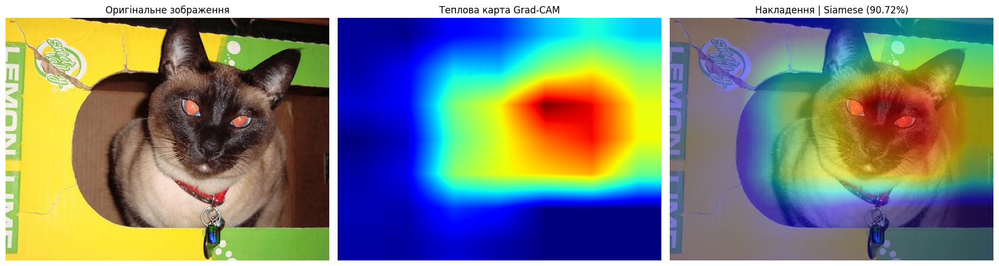

  img_0067.jpg: Siamese (90.72%)



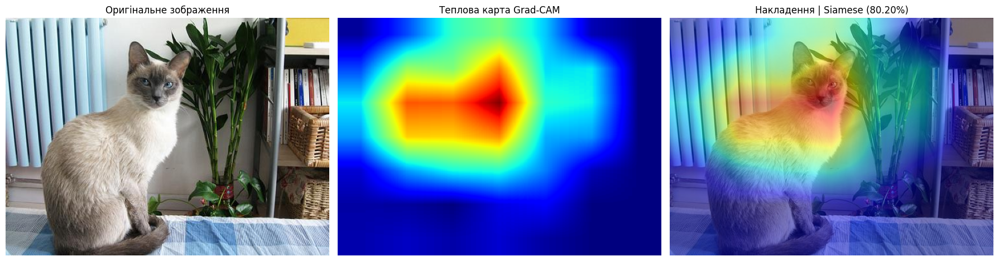

  img_0072.jpg: Siamese (80.20%)



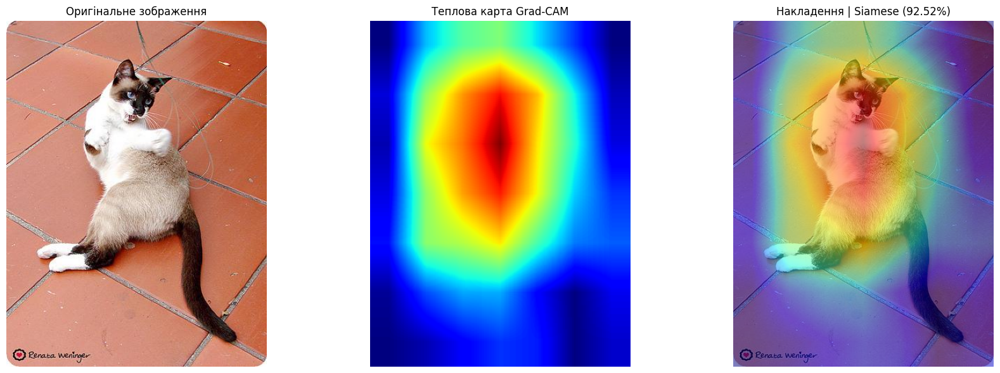

  img_0096.jpg: Siamese (92.52%)



In [22]:
# 4.3 Застосування Grad-CAM до зображень класу A

print(f"Grad-CAM для класу '{CLASS_A}':\n")

class_a_images = list(Path(f"dataset/{CLASS_A}").glob("*"))[:3]
for img_path in class_a_images:
    pred, conf = visualize_gradcam(
        model, img_path, val_transform, full_dataset.classes, device
    )
    print(f"  {img_path.name}: {full_dataset.classes[pred]} ({conf:.2%})\n")

Grad-CAM для класу 'Persian':



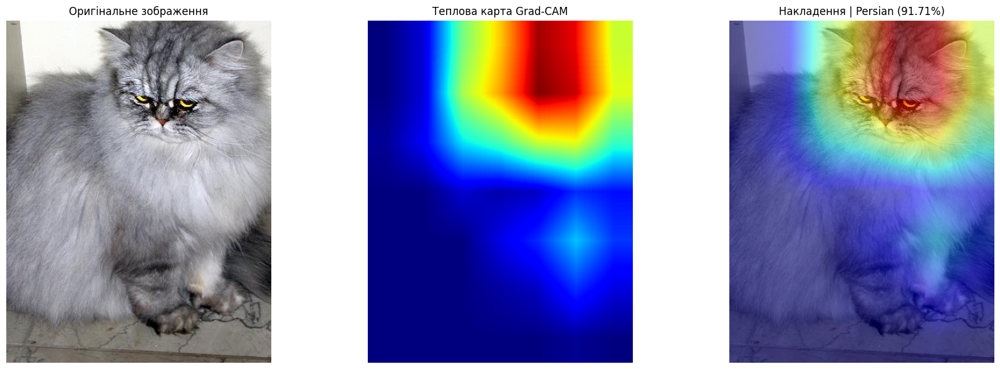

  img_0067.jpg: Persian (91.71%)



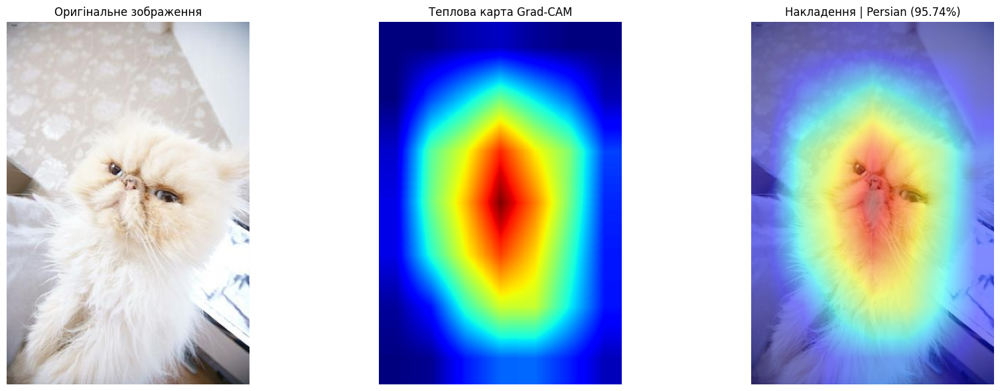

  img_0072.jpg: Persian (95.74%)



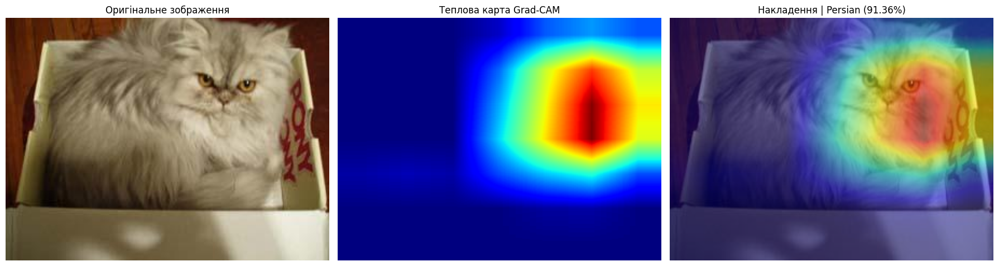

  img_0096.jpg: Persian (91.36%)



In [23]:
# 4.4 Застосування Grad-CAM до зображень класу B

print(f"Grad-CAM для класу '{CLASS_B}':\n")

class_b_images = list(Path(f"dataset/{CLASS_B}").glob("*"))[:3]
for img_path in class_b_images:
    pred, conf = visualize_gradcam(
        model, img_path, val_transform, full_dataset.classes, device
    )
    print(f"  {img_path.name}: {full_dataset.classes[pred]} ({conf:.2%})\n")

### Аналіз результатів Grad-CAM

**Дайте відповідь на наступні питання (у звіті):**

1. На які частини зображення звертає увагу модель?
2. Чи відрізняються ділянки уваги для різних класів?
3. Чи завжди модель «дивиться» на правильний об'єкт? Чи бувають випадки фокусу на фоні?
4. Яка роздільність теплової карти? Чи можна за нею точно визначити межі об'єкта?

**Зверніть увагу:** теплова карта Grad-CAM є розмитою, оскільки вона має роздільність останнього згорткового шару (7×7 для ResNet-18). Це мотивує перехід до семантичної сегментації, яка дає піксельно-точні маски.

---
## Етап 5. Семантична сегментація з попередньо натренованою моделлю

Семантична сегментація класифікує кожен піксель зображення. Використаємо попередньо натреновану модель **DeepLabV3** з torchvision (навчена на COCO/VOC, 21 клас).

In [24]:
# 5.1 Завантаження попередньо натренованої моделі DeepLabV3

from torchvision.models.segmentation import (
    deeplabv3_resnet50,
    DeepLabV3_ResNet50_Weights,
)

seg_weights = DeepLabV3_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1
seg_model = deeplabv3_resnet50(weights=seg_weights).to(device)
seg_model.eval()

# Класи COCO/VOC (21 клас)
COCO_CLASSES = [
    "фон", "аероплан", "велосипед", "птах", "човен",
    "пляшка", "автобус", "автомобіль", "кіт", "стілець",
    "корова", "обідній стіл", "собака", "кінь", "мотоцикл",
    "людина", "горщична рослина", "вівця", "диван", "потяг",
    "монітор",
]


def get_color_palette(num_classes):
    """Генерує палітру кольорів для візуалізації масок (палітра VOC)."""
    palette = np.zeros((num_classes, 3), dtype=np.uint8)
    for i in range(num_classes):
        r, g, b = 0, 0, 0
        c = i
        for j in range(8):
            r |= ((c >> 0) & 1) << (7 - j)
            g |= ((c >> 1) & 1) << (7 - j)
            b |= ((c >> 2) & 1) << (7 - j)
            c >>= 3
        palette[i] = [r, g, b]
    return palette


PALETTE = get_color_palette(len(COCO_CLASSES))

print(f"Модель DeepLabV3 завантажена на {device}")
print(f"Кількість класів: {len(COCO_CLASSES)}")
print(f"Класи: {', '.join(COCO_CLASSES)}")

Downloading: "https://download.pytorch.org/models/deeplabv3_resnet50_coco-cd0a2569.pth" to /root/.cache/torch/hub/checkpoints/deeplabv3_resnet50_coco-cd0a2569.pth


100%|██████████| 161M/161M [00:01<00:00, 138MB/s]  


Модель DeepLabV3 завантажена на cuda
Кількість класів: 21
Класи: фон, аероплан, велосипед, птах, човен, пляшка, автобус, автомобіль, кіт, стілець, корова, обідній стіл, собака, кінь, мотоцикл, людина, горщична рослина, вівця, диван, потяг, монітор


In [25]:
# 5.2 Функції сегментації та візуалізації

seg_transform = transforms.Compose([
    transforms.Resize(520),
    transforms.ToTensor(),
    transforms.Normalize(mean=IMAGENET_MEAN, std=IMAGENET_STD),
])


def segment_image(model, image_path, transform, device):
    """Виконує семантичну сегментацію зображення."""
    image = Image.open(image_path).convert("RGB")
    input_tensor = transform(image).unsqueeze(0).to(device)

    with torch.no_grad():
        output = model(input_tensor)["out"]
        predictions = output.argmax(1).squeeze().cpu().numpy()

    return image, predictions


def visualize_segmentation(image, predictions, alpha=0.4):
    """Візуалізує результати сегментації."""
    # Кольорова маска
    color_mask = PALETTE[predictions]
    color_mask_img = Image.fromarray(color_mask).resize(image.size, Image.NEAREST)

    fig, axes = plt.subplots(1, 3, figsize=(20, 7))

    axes[0].imshow(image)
    axes[0].set_title("Оригінальне зображення")
    axes[0].axis("off")

    axes[1].imshow(color_mask_img)
    axes[1].set_title("Маска сегментації")
    axes[1].axis("off")

    # Накладення
    blended = Image.blend(
        image.resize(color_mask_img.size), color_mask_img.convert("RGB"), alpha=alpha
    )
    axes[2].imshow(blended)
    axes[2].set_title("Накладення маски")
    axes[2].axis("off")

    # Які класи виявлені?
    unique_classes = np.unique(predictions)
    detected = [f"{COCO_CLASSES[c]}" for c in unique_classes if c > 0]
    if detected:
        print(f"  Виявлені класи: {', '.join(detected)}")
    else:
        print("  Виявлено лише фон")

    plt.tight_layout()
    plt.show()


print("Функції сегментації готові.")

Функції сегментації готові.


Сегментація зображень класу 'Siamese':

Зображення: img_0067.jpg
  Виявлені класи: кіт


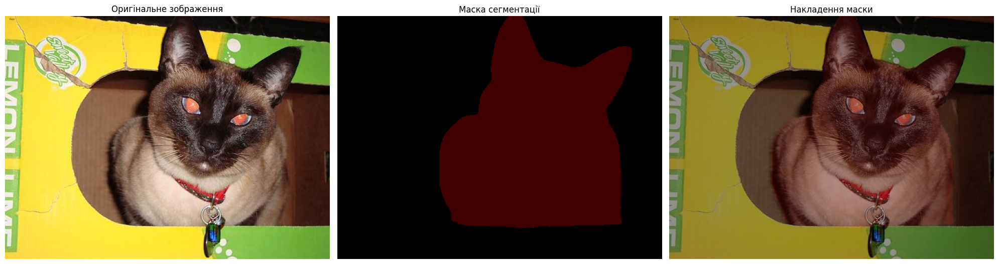


Зображення: img_0072.jpg
  Виявлені класи: кіт, стілець, обідній стіл, горщична рослина


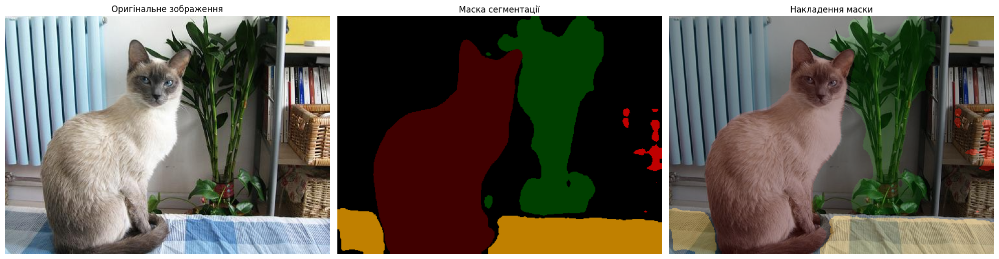


Сегментація зображень класу 'Persian':

Зображення: img_0067.jpg
  Виявлені класи: кіт


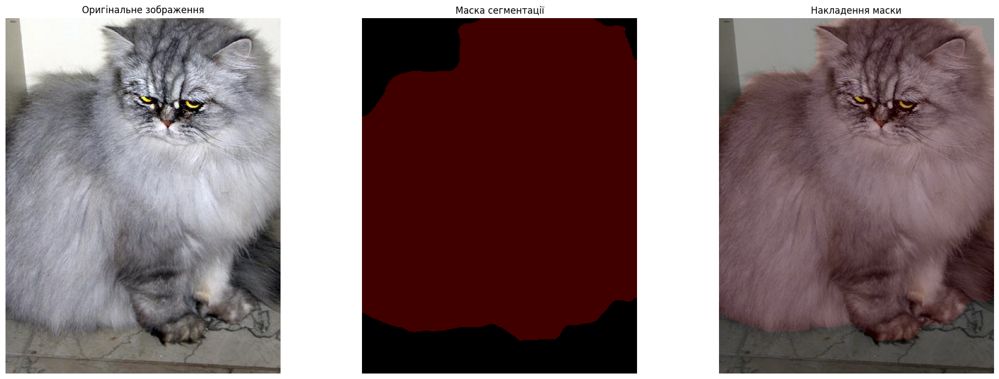


Зображення: img_0072.jpg
  Виявлені класи: кіт


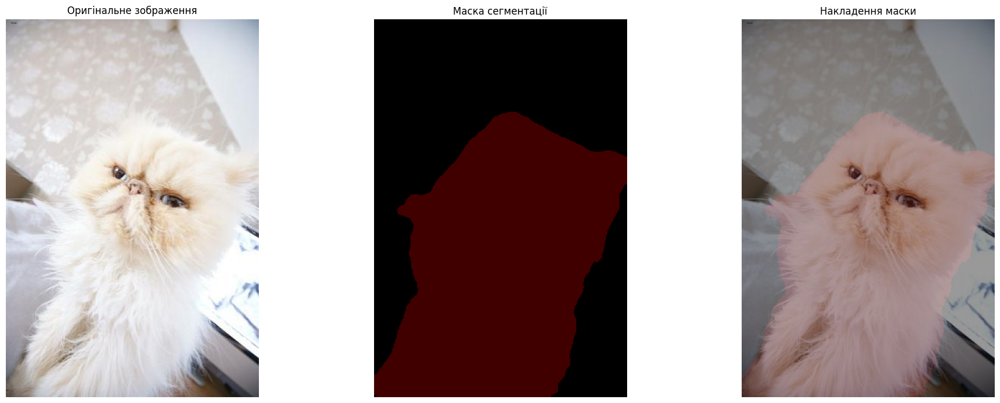

In [26]:
# 5.3 Сегментація зображень з вашого набору даних

print(f"Сегментація зображень класу '{CLASS_A}':\n")
for img_path in class_a_images[:2]:
    print(f"Зображення: {img_path.name}")
    image, predictions = segment_image(seg_model, img_path, seg_transform, device)
    visualize_segmentation(image, predictions)
    print()

print(f"Сегментація зображень класу '{CLASS_B}':\n")
for img_path in class_b_images[:2]:
    print(f"Зображення: {img_path.name}")
    image, predictions = segment_image(seg_model, img_path, seg_transform, device)
    visualize_segmentation(image, predictions)
    print()

Завантаження додаткових зображень з набору даних...

Зображення: Beagle
  Виявлені класи: собака


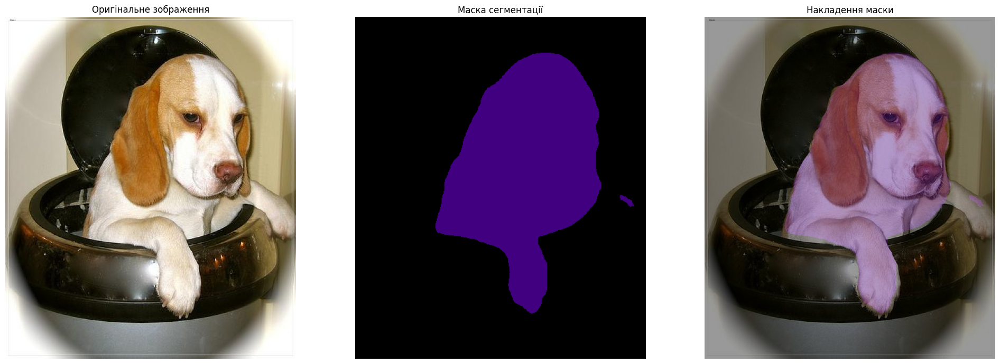


Зображення: Newfoundland
  Виявлені класи: собака


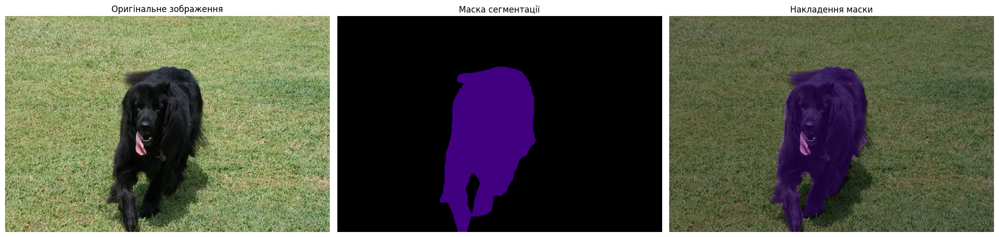


Зображення: Bombay
  Виявлені класи: кіт


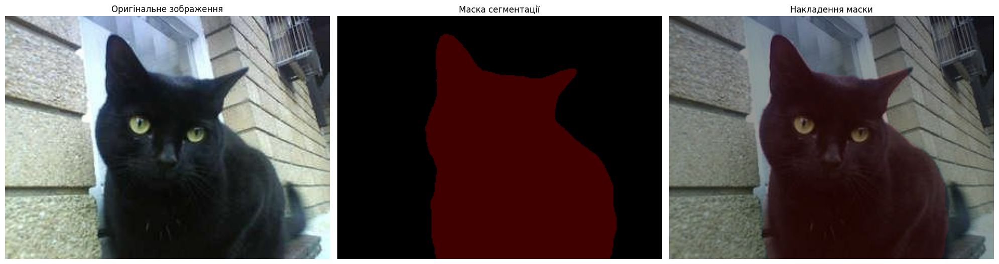


Зображення: Ragdoll
  Виявлені класи: кіт, стілець


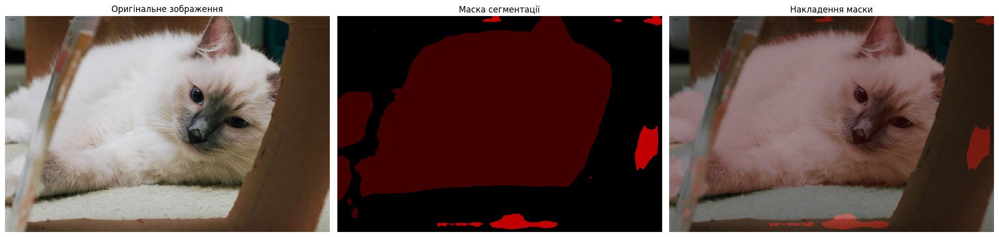


Зображення: Sphynx
  Виявлені класи: кіт, собака, людина


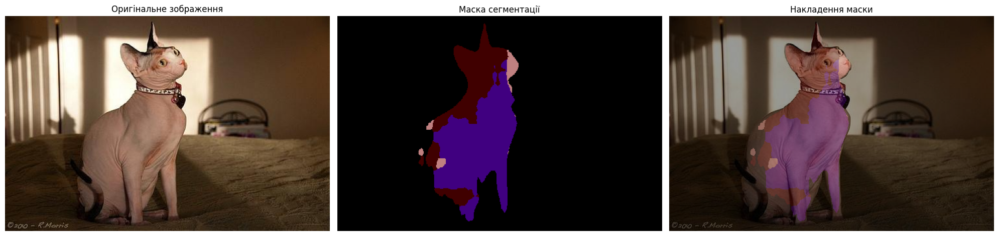

In [27]:
# 5.4 Сегментація додаткових зображень з набору даних
#     (для більш різноманітних результатів сегментації)

import random

print("Завантаження додаткових зображень з набору даних...\n")

# Візьмемо кілька довільних зображень з повного набору (інших класів)
random.seed(123)
extra_indices = random.sample(range(len(raw_dataset)), 5)

os.makedirs("test_segmentation", exist_ok=True)

for i, idx in enumerate(extra_indices):
    try:
        img, label = raw_dataset[idx]
        if DATASET_NAME == "OxfordIIITPet":
            cls_name = raw_dataset.classes[label]
        else:
            cls_name = raw_dataset.categories[label]
        tmp_path = f"test_segmentation/test_{i}.jpg"
        img.convert("RGB").save(tmp_path)
        print(f"Зображення: {cls_name}")
        image, predictions = segment_image(seg_model, tmp_path, seg_transform, device)
        visualize_segmentation(image, predictions)
        print()
    except Exception as e:
        print(f"Помилка: {e}")

Порівняння Grad-CAM та сегментації:


Зображення: img_0067.jpg


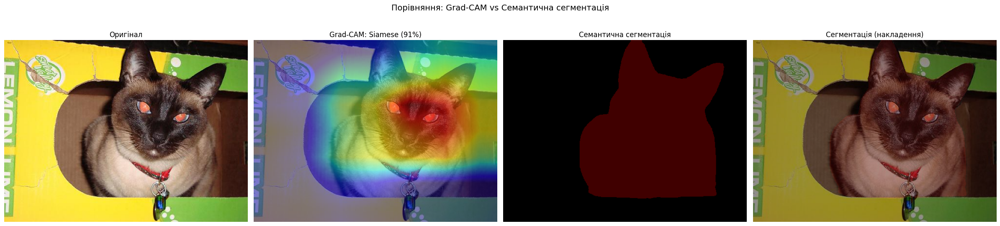

  Класифікація: Siamese (90.72%)
  Сегментовані класи: кіт


Зображення: img_0072.jpg


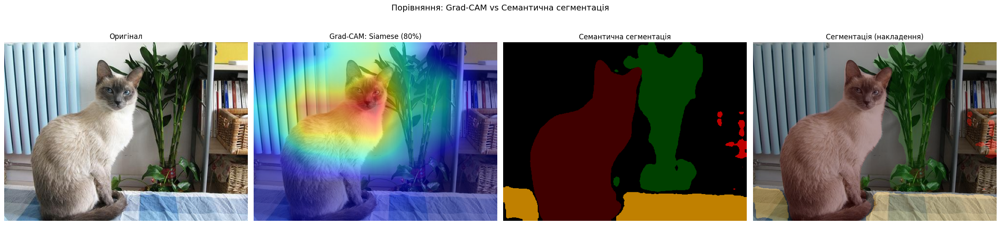

  Класифікація: Siamese (80.20%)
  Сегментовані класи: кіт, стілець, обідній стіл, горщична рослина


Зображення: img_0067.jpg


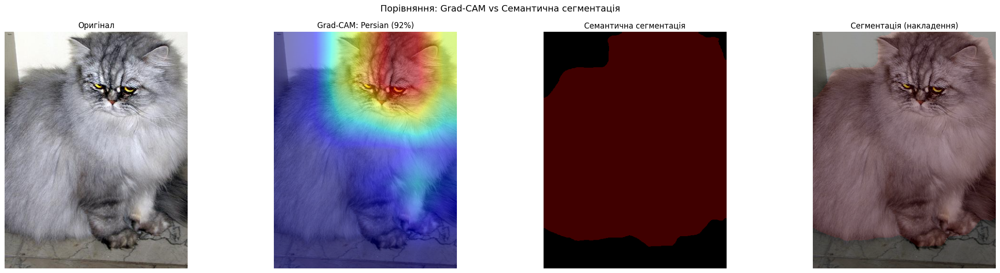

  Класифікація: Persian (91.71%)
  Сегментовані класи: кіт


Зображення: img_0072.jpg


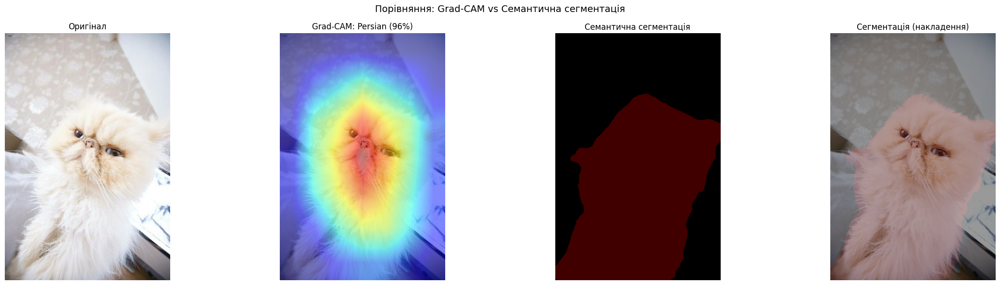

  Класифікація: Persian (95.74%)
  Сегментовані класи: кіт



In [28]:
# 5.5 Порівняння Grad-CAM та сегментації на одному зображенні


def compare_gradcam_and_segmentation(
    cls_model, seg_model, image_path, cls_transform, seg_transform, cls_classes, device
):
    """Порівнює Grad-CAM класифікатора з семантичною сегментацією."""
    image = Image.open(image_path).convert("RGB")

    # --- Grad-CAM ---
    grad_cam = GradCAM(cls_model, cls_model.layer4[-1].conv2)
    cls_input = cls_transform(image).unsqueeze(0).to(device)
    cls_input.requires_grad = True
    cam, pred_class = grad_cam.generate(cls_input)
    cam_resized = np.array(
        Image.fromarray((cam * 255).astype(np.uint8)).resize(
            image.size, Image.BILINEAR
        )
    ) / 255.0
    grad_cam.remove_hooks()

    # Ймовірність класифікації
    cls_model.eval()
    with torch.no_grad():
        output = cls_model(cls_transform(image).unsqueeze(0).to(device))
        probs = torch.softmax(output, dim=1)
        confidence = probs[0, pred_class].item()

    # --- Сегментація ---
    seg_input = seg_transform(image).unsqueeze(0).to(device)
    with torch.no_grad():
        seg_output = seg_model(seg_input)["out"]
        seg_preds = seg_output.argmax(1).squeeze().cpu().numpy()
    seg_mask = PALETTE[seg_preds]
    seg_mask_img = Image.fromarray(seg_mask).resize(image.size, Image.NEAREST)

    # --- Візуалізація ---
    fig, axes = plt.subplots(1, 4, figsize=(24, 6))

    axes[0].imshow(image)
    axes[0].set_title("Оригінал")
    axes[0].axis("off")

    axes[1].imshow(image)
    axes[1].imshow(cam_resized, cmap="jet", alpha=0.5)
    axes[1].set_title(f"Grad-CAM: {cls_classes[pred_class]} ({confidence:.0%})")
    axes[1].axis("off")

    axes[2].imshow(seg_mask_img)
    axes[2].set_title("Семантична сегментація")
    axes[2].axis("off")

    blended = Image.blend(image.resize(seg_mask_img.size), seg_mask_img.convert("RGB"), alpha=0.4)
    axes[3].imshow(blended)
    axes[3].set_title("Сегментація (накладення)")
    axes[3].axis("off")

    plt.suptitle(f"Порівняння: Grad-CAM vs Семантична сегментація", fontsize=14)
    plt.tight_layout()
    plt.show()

    unique = np.unique(seg_preds)
    detected = [COCO_CLASSES[c] for c in unique if c > 0]
    print(f"  Класифікація: {cls_classes[pred_class]} ({confidence:.2%})")
    print(f"  Сегментовані класи: {', '.join(detected) if detected else 'лише фон'}")


# Застосуємо до зображень з набору даних
print("Порівняння Grad-CAM та сегментації:\n")
for img_path in class_a_images[:2] + class_b_images[:2]:
    print(f"\nЗображення: {img_path.name}")
    compare_gradcam_and_segmentation(
        model, seg_model, img_path, val_transform, seg_transform,
        full_dataset.classes, device
    )
    print()

---
## Етап 6. Комбінований конвеєр: сегментація + класифікація

Побудуємо конвеєр, що:
1. Сегментує зображення (виділяє об'єкти)
2. Витягує окремі регіони за класами сегментації
3. Класифікує кожен регіон нашим класифікатором

In [29]:
# 6.1 Функція витягування регіонів з маски сегментації


def extract_regions_by_class(image, predictions, target_classes, min_area=500):
    """
    Витягує прямокутні регіони зображення,
    що відповідають вказаним класам сегментації.
    """
    image_np = np.array(image)
    regions = []

    for cls_id in target_classes:
        mask = predictions == cls_id
        if mask.sum() < min_area:
            continue

        # Масштабуємо маску до розміру зображення
        mask_resized = (
            np.array(
                Image.fromarray(mask.astype(np.uint8) * 255).resize(
                    image.size, Image.NEAREST
                )
            )
            > 0
        )

        # Знаходимо bounding box
        rows = np.any(mask_resized, axis=1)
        cols = np.any(mask_resized, axis=0)
        if not rows.any() or not cols.any():
            continue
        rmin, rmax = np.where(rows)[0][[0, -1]]
        cmin, cmax = np.where(cols)[0][[0, -1]]

        # Перевіряємо мінімальний розмір регіону
        if (rmax - rmin) < 20 or (cmax - cmin) < 20:
            continue

        # Вирізаємо регіон
        region = image_np[rmin : rmax + 1, cmin : cmax + 1]
        regions.append(
            {
                "image": Image.fromarray(region),
                "class_id": cls_id,
                "class_name": COCO_CLASSES[cls_id],
                "bbox": (cmin, rmin, cmax, rmax),
            }
        )

    return regions


print("Функція extract_regions_by_class готова.")

Функція extract_regions_by_class готова.


In [30]:
# 6.2 Комбінований конвеєр


def pipeline(
    cls_model, seg_model, image_path, cls_transform, seg_transform,
    cls_classes, device, target_seg_classes=None,
):
    """
    Комбінований конвеєр:
    1. Сегментує зображення
    2. Виділяє регіони за класами сегментації
    3. Класифікує кожен регіон власним класифікатором
    """
    image = Image.open(image_path).convert("RGB")

    # Крок 1: Сегментація
    print("  Крок 1: Сегментація...")
    seg_input = seg_transform(image).unsqueeze(0).to(device)
    with torch.no_grad():
        seg_output = seg_model(seg_input)["out"]
        seg_preds = seg_output.argmax(1).squeeze().cpu().numpy()

    unique = np.unique(seg_preds)
    detected = [f"{COCO_CLASSES[c]}" for c in unique if c > 0]
    print(f"  Виявлені сегменти: {', '.join(detected) if detected else 'лише фон'}")

    # Крок 2: Витягуємо регіони
    print("  Крок 2: Витягування регіонів...")
    if target_seg_classes is None:
        target_seg_classes = [c for c in unique if c > 0]

    regions = extract_regions_by_class(image, seg_preds, target_seg_classes)

    if not regions:
        print("  Не знайдено об'єктів для класифікації.")
        # Показуємо хоча б сегментацію
        seg_mask = PALETTE[seg_preds]
        seg_mask_img = Image.fromarray(seg_mask).resize(image.size, Image.NEAREST)
        fig, axes = plt.subplots(1, 2, figsize=(12, 5))
        axes[0].imshow(image)
        axes[0].set_title("Оригінал")
        axes[0].axis("off")
        axes[1].imshow(seg_mask_img)
        axes[1].set_title("Сегментація (об'єкти не знайдені)")
        axes[1].axis("off")
        plt.tight_layout()
        plt.show()
        return

    # Крок 3: Класифікуємо кожен регіон
    print(f"  Крок 3: Класифікація {len(regions)} регіон(ів)...\n")

    n_show = min(len(regions), 4)
    fig, axes = plt.subplots(1, n_show + 1, figsize=(5 * (n_show + 1), 5))

    # Показуємо оригінал з bounding boxes
    axes[0].imshow(image)
    axes[0].set_title("Оригінал + регіони")
    axes[0].axis("off")
    for region in regions[:n_show]:
        cmin, rmin, cmax, rmax = region["bbox"]
        rect = plt.Rectangle(
            (cmin, rmin), cmax - cmin, rmax - rmin,
            linewidth=2, edgecolor="lime", facecolor="none"
        )
        axes[0].add_patch(rect)
        axes[0].text(
            cmin, rmin - 5, region["class_name"],
            color="lime", fontsize=9, weight="bold",
            bbox=dict(boxstyle="round,pad=0.2", facecolor="black", alpha=0.7)
        )

    for i, region in enumerate(regions[:n_show]):
        region_tensor = cls_transform(region["image"]).unsqueeze(0).to(device)
        cls_model.eval()
        with torch.no_grad():
            output = cls_model(region_tensor)
            probs = torch.softmax(output, dim=1)
            pred = probs.argmax(dim=1).item()
            conf = probs[0, pred].item()

        title = (
            f"Сегмент: {region['class_name']}\n"
            f"Класифікація: {cls_classes[pred]} ({conf:.0%})"
        )
        axes[i + 1].imshow(region["image"])
        axes[i + 1].set_title(title, fontsize=10)
        axes[i + 1].axis("off")

        print(
            f"  Регіон {i + 1}: сегмент '{region['class_name']}' -> "
            f"класифіковано як '{cls_classes[pred]}' ({conf:.2%})"
        )

    plt.tight_layout()
    plt.show()


print("Конвеєр pipeline() готовий.")

Конвеєр pipeline() готовий.


ТЕСТУВАННЯ КОМБІНОВАНОГО КОНВЕЄРУ

Зображення: img_0067.jpg
----------------------------------------
  Крок 1: Сегментація...
  Виявлені сегменти: кіт
  Крок 2: Витягування регіонів...
  Крок 3: Класифікація 1 регіон(ів)...

  Регіон 1: сегмент 'кіт' -> класифіковано як 'Siamese' (94.24%)


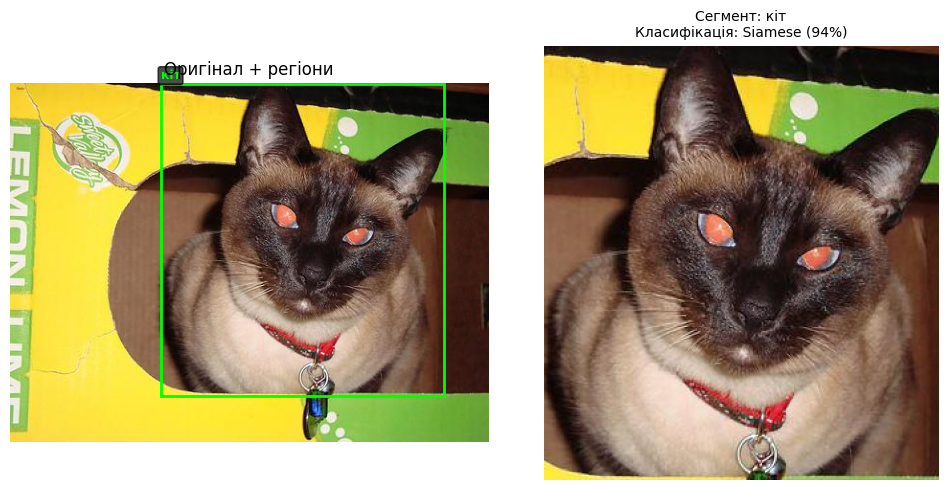



Зображення: img_0072.jpg
----------------------------------------
  Крок 1: Сегментація...
  Виявлені сегменти: кіт, стілець, обідній стіл, горщична рослина
  Крок 2: Витягування регіонів...
  Крок 3: Класифікація 4 регіон(ів)...

  Регіон 1: сегмент 'кіт' -> класифіковано як 'Siamese' (95.06%)
  Регіон 2: сегмент 'стілець' -> класифіковано як 'Siamese' (58.22%)
  Регіон 3: сегмент 'обідній стіл' -> класифіковано як 'Siamese' (63.09%)
  Регіон 4: сегмент 'горщична рослина' -> класифіковано як 'Siamese' (97.35%)


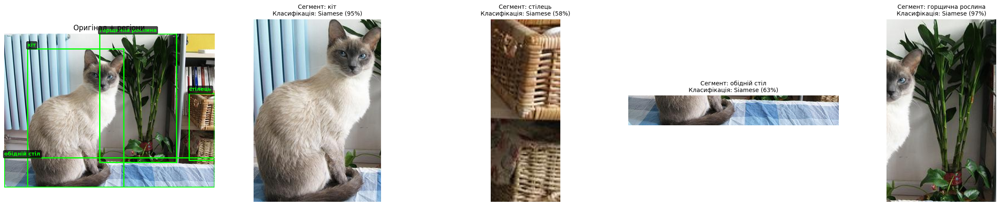



Зображення: img_0067.jpg
----------------------------------------
  Крок 1: Сегментація...
  Виявлені сегменти: кіт
  Крок 2: Витягування регіонів...
  Крок 3: Класифікація 1 регіон(ів)...

  Регіон 1: сегмент 'кіт' -> класифіковано як 'Persian' (87.66%)


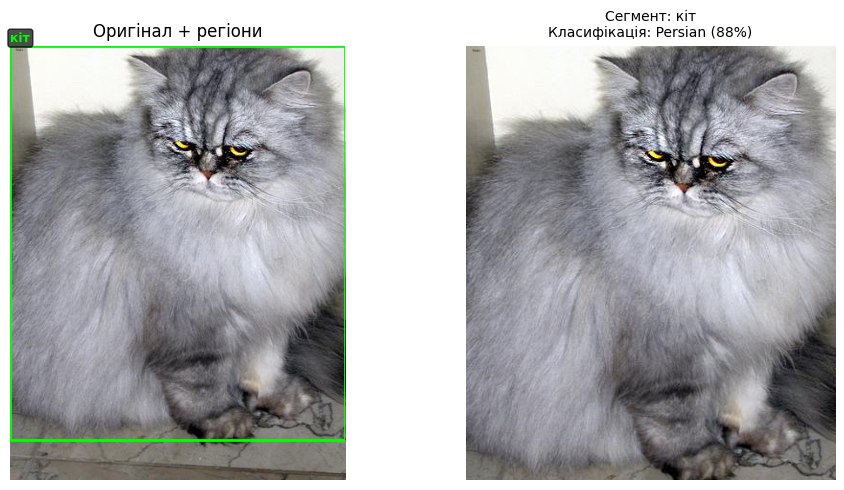



Зображення: img_0072.jpg
----------------------------------------
  Крок 1: Сегментація...
  Виявлені сегменти: кіт
  Крок 2: Витягування регіонів...
  Крок 3: Класифікація 1 регіон(ів)...

  Регіон 1: сегмент 'кіт' -> класифіковано як 'Persian' (96.10%)


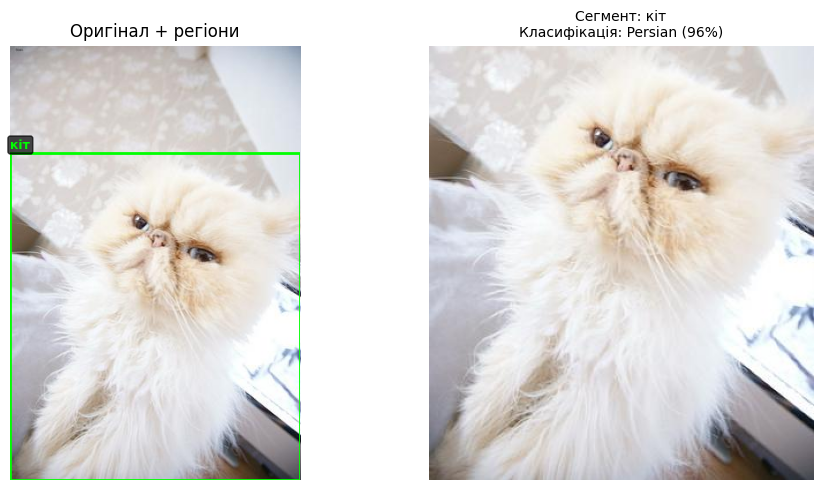

In [31]:
# 6.3 Тестування конвеєру на зображеннях з набору даних

print("=" * 60)
print("ТЕСТУВАННЯ КОМБІНОВАНОГО КОНВЕЄРУ")
print("=" * 60)

test_images_pipeline = class_a_images[:2] + class_b_images[:2]
for img_path in test_images_pipeline:
    print(f"\nЗображення: {img_path.name}")
    print("-" * 40)
    pipeline(
        model, seg_model, img_path, val_transform, seg_transform,
        full_dataset.classes, device
    )
    print()

Конвеєр на тестових зображеннях з кількома об'єктами:


Зображення: test_3.jpg
----------------------------------------
  Крок 1: Сегментація...
  Виявлені сегменти: кіт, стілець
  Крок 2: Витягування регіонів...
  Крок 3: Класифікація 2 регіон(ів)...

  Регіон 1: сегмент 'кіт' -> класифіковано як 'Siamese' (80.38%)
  Регіон 2: сегмент 'стілець' -> класифіковано як 'Persian' (52.73%)


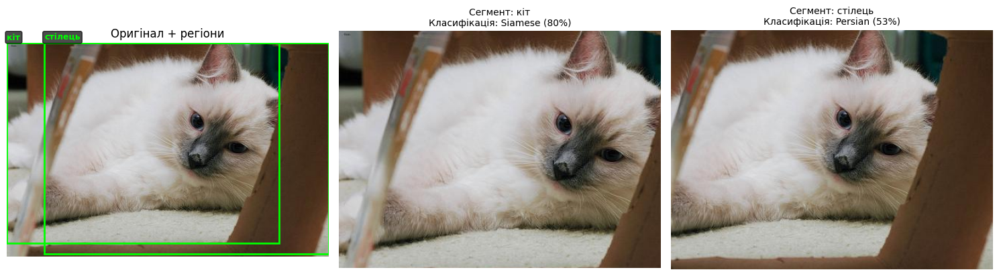


Зображення: test_1.jpg
----------------------------------------
  Крок 1: Сегментація...
  Виявлені сегменти: собака
  Крок 2: Витягування регіонів...
  Крок 3: Класифікація 1 регіон(ів)...

  Регіон 1: сегмент 'собака' -> класифіковано як 'Siamese' (71.48%)


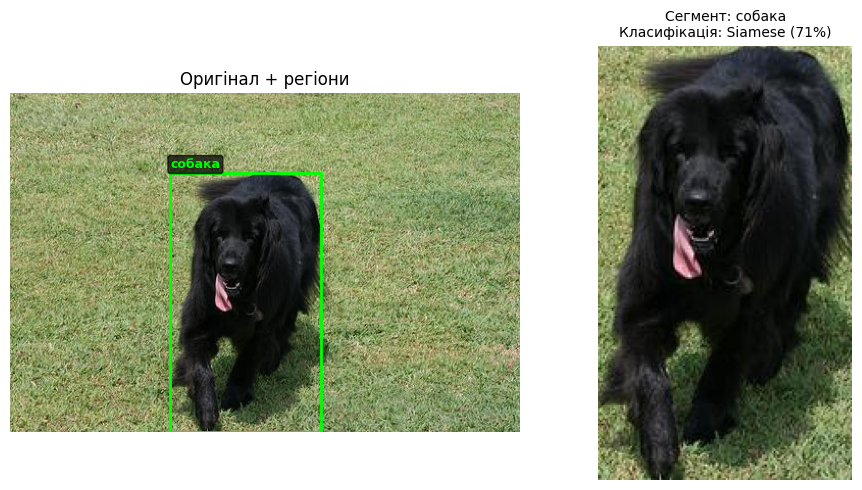

In [32]:
# 6.4 Тестування конвеєру на тестових зображеннях
#     (зображення з кількома об'єктами, завантажені на етапі 5.4)

test_seg_images = list(Path("test_segmentation").glob("*.jpg"))
if test_seg_images:
    print("Конвеєр на тестових зображеннях з кількома об'єктами:\n")
    for img_path in test_seg_images[:2]:
        print(f"\nЗображення: {img_path.name}")
        print("-" * 40)
        pipeline(
            model, seg_model, str(img_path), val_transform, seg_transform,
            full_dataset.classes, device
        )
else:
    print("Тестові зображення не знайдені. Пропускаємо цей крок.")

---
## Етап 7 (бонусний). Тонке налаштування легкої моделі сегментації

**⚠️ Цей етап необов'язковий і потребує додаткового часу GPU.**

Ідея: використати маски від великої моделі DeepLabV3 як «псевдо-мітки» для тренування легшої моделі (FCN або LRASPP-MobileNet).

In [33]:
# 7.1 Завантаження легкої моделі сегментації (FCN-ResNet50)

from torchvision.models.segmentation import fcn_resnet50

# Легша модель без попередніх ваг — будемо тренувати на псевдо-мітках
light_seg_model = fcn_resnet50(weights=None, num_classes=21).to(device)

total_params = sum(p.numel() for p in light_seg_model.parameters())
print(f"FCN-ResNet50: {total_params:,} параметрів")

# Для порівняння:
deeplabv3_params = sum(p.numel() for p in seg_model.parameters())
print(f"DeepLabV3-ResNet50: {deeplabv3_params:,} параметрів")

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


100%|██████████| 97.8M/97.8M [00:00<00:00, 208MB/s]


FCN-ResNet50: 32,957,013 параметрів
DeepLabV3-ResNet50: 42,004,074 параметрів


In [34]:
# 7.2 Генерація псевдо-міток та підготовка даних


class PseudoLabelSegDataset(Dataset):
    """Набір даних з псевдо-мітками від моделі-вчителя."""

    def __init__(self, image_paths, teacher_model, transform, device, target_size=256):
        self.image_paths = image_paths
        self.transform = transform
        self.target_size = target_size
        self.resize = transforms.Resize(target_size)

        # Генеруємо псевдо-мітки
        print(f"Генерація псевдо-міток для {len(image_paths)} зображень...")
        self.labels = []
        teacher_model.eval()
        for path in image_paths:
            try:
                image = Image.open(path).convert("RGB")
                input_t = transform(image).unsqueeze(0).to(device)
                with torch.no_grad():
                    output = teacher_model(input_t)["out"]
                    pred = output.argmax(1).squeeze().cpu()
                self.labels.append(pred)
            except Exception as e:
                print(f"  Пропущено {path}: {e}")
                self.labels.append(None)
        # Видаляємо проблемні зображення
        valid = [(p, l) for p, l in zip(self.image_paths, self.labels) if l is not None]
        self.image_paths = [v[0] for v in valid]
        self.labels = [v[1] for v in valid]
        print(f"Готово: {len(self.labels)} зображень з мітками.")

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = Image.open(self.image_paths[idx]).convert("RGB")
        image = self.resize(image)
        image = transforms.ToTensor()(image)
        image = transforms.Normalize(mean=IMAGENET_MEAN, std=IMAGENET_STD)(image)

        label = self.labels[idx]
        # Resize label to match target size
        label = torch.nn.functional.interpolate(
            label.unsqueeze(0).unsqueeze(0).float(), size=self.target_size, mode="nearest"
        ).squeeze().long()

        return image, label


# Збираємо всі зображення з набору даних
all_images = (
    list(Path(f"dataset/{CLASS_A}").glob("*"))
    + list(Path(f"dataset/{CLASS_B}").glob("*"))
)

pseudo_dataset = PseudoLabelSegDataset(
    all_images, seg_model, seg_transform, device, target_size=256
)

pseudo_loader = DataLoader(pseudo_dataset, batch_size=4, shuffle=True)

Генерація псевдо-міток для 199 зображень...
Готово: 199 зображень з мітками.


In [ ]:
# 7.3 Тренування легкої моделі

LIGHT_EPOCHS = 5

seg_optimizer = optim.Adam(light_seg_model.parameters(), lr=1e-4)
seg_criterion = nn.CrossEntropyLoss()

print(f"Тренування FCN-ResNet50 ({LIGHT_EPOCHS} епох)...")
print("-" * 50)

for epoch in range(LIGHT_EPOCHS):
    light_seg_model.train()
    running_loss = 0.0
    num_batches = 0

    for images, labels in pseudo_loader:
        images, labels = images.to(device), labels.to(device)

        seg_optimizer.zero_grad()
        outputs = light_seg_model(images)["out"]

        # Resize outputs to match labels if needed
        if outputs.shape[-2:] != labels.shape[-2:]:
            outputs = torch.nn.functional.interpolate(
                outputs, size=labels.shape[-2:], mode="bilinear", align_corners=False
            )

        loss = seg_criterion(outputs, labels)
        loss.backward()
        seg_optimizer.step()

        running_loss += loss.item()
        num_batches += 1

    avg_loss = running_loss / max(num_batches, 1)
    print(f"Епоха {epoch + 1}/{LIGHT_EPOCHS} | Loss: {avg_loss:.4f}")

print("\nТренування завершено.")

In [ ]:
# 7.4 Порівняння результатів легкої моделі з DeepLabV3

import time


def compare_segmentation_models(image_path, teacher_model, student_model, transform, device):
    """Порівнює результати двох моделей сегментації."""
    image = Image.open(image_path).convert("RGB")

    # DeepLabV3 (вчитель)
    teacher_model.eval()
    input_t = transform(image).unsqueeze(0).to(device)
    start = time.time()
    with torch.no_grad():
        teacher_out = teacher_model(input_t)["out"].argmax(1).squeeze().cpu().numpy()
    teacher_time = time.time() - start

    # FCN (учень)
    student_model.eval()
    # Student uses smaller input
    small_transform = transforms.Compose([
        transforms.Resize(256),
        transforms.ToTensor(),
        transforms.Normalize(mean=IMAGENET_MEAN, std=IMAGENET_STD),
    ])
    input_s = small_transform(image).unsqueeze(0).to(device)
    start = time.time()
    with torch.no_grad():
        student_out = student_model(input_s)["out"].argmax(1).squeeze().cpu().numpy()
    student_time = time.time() - start

    # Візуалізація
    teacher_mask = Image.fromarray(PALETTE[teacher_out]).resize(image.size, Image.NEAREST)
    student_mask = Image.fromarray(PALETTE[student_out]).resize(image.size, Image.NEAREST)

    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    axes[0].imshow(image)
    axes[0].set_title("Оригінал")
    axes[0].axis("off")

    axes[1].imshow(teacher_mask)
    axes[1].set_title(f"DeepLabV3 ({teacher_time:.3f}s)")
    axes[1].axis("off")

    axes[2].imshow(student_mask)
    axes[2].set_title(f"FCN-ResNet50 ({student_time:.3f}s)")
    axes[2].axis("off")

    plt.tight_layout()
    plt.show()

    print(f"  DeepLabV3: {teacher_time:.3f}s | FCN: {student_time:.3f}s")


print("Порівняння моделей сегментації:\n")
for img_path in class_a_images[:1] + class_b_images[:1]:
    print(f"Зображення: {img_path.name}")
    compare_segmentation_models(
        img_path, seg_model, light_seg_model, seg_transform, device
    )
    print()

---
## Підсумок

У цій лабораторній роботі ви:

1. **Підготували набір даних** для бінарної класифікації з аугментацією
2. **Натренували класифікатор** на базі ResNet-18 із передавальним навчанням
3. **Візуалізували рішення** моделі за допомогою Grad-CAM
4. **Застосували семантичну сегментацію** за допомогою попередньо натренованої DeepLabV3
5. **Порівняли** Grad-CAM (розмита область уваги) з сегментацією (точні піксельні маски)
6. **Побудували конвеєр**, що поєднує сегментацію та класифікацію

### Для звіту не забудьте:
- Скріншоти всіх візуалізацій
- Графіки навчання
- Аналіз теплових карт Grad-CAM
- Порівняння Grad-CAM та сегментації
- Висновки по кожному етапу